In [1]:
import tensorflow as tf
tf.__version__
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("../..")
import cv2
import numpy as np
from glob import glob
from models import Yolov4

In [2]:
yolo_model = Yolov4(class_name_path='../../class_names/butelka_classes.txt')

Yolov4
(416, 416, 3)
Build model


2022-01-03 13:31:17.244047: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-03 13:31:17.257073: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-03 13:31:17.257969: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-03 13:31:17.260198: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-03 13:31:17.261057: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read f

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 416, 416, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 416, 416, 32) 0           batch_normalization[0][0]        
____________________________________________________________________________________________

nms iou: 0.413 score: 0.3


In [3]:
yolo_model.load_model('../butelki_yolo/wagi')

nms iou: 0.413 score: 0.3


In [4]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
from keras.models import load_model
img_classifier_width, img_classifier_height =  216, 384

In [5]:
class_names = ['pelna', 'w_czesci', 'pusta']

In [6]:
classifier = load_model('najnowszesupersieczaug.h5')

In [7]:
img_path = '../dataset/valid_images/IMG20211101140317_00.jpg'
img_width, img_height = 312, 416

In [8]:
def crop_roi(detections, orig_img):
    imgs = []
    for detection in detections.values:
        cropped_img = orig_img[detection[1]:detection[3], detection[0]:detection[2]]
        imgs.append(cropped_img)
    return imgs

In [9]:
def to_grayscale_then_rgb(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_rgb = cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB)
    return gray_rgb

In [10]:
def make_prediction(img, model, show_image = False):
    if(show_image):
        plt.imshow(img)
    img = cv2.resize(img, (img_classifier_width, img_classifier_height))
    #img = to_grayscale_then_rgb(img)
    if(show_image):
        plt.imshow(img)
        plt.show()
    img.shape
    #img = np.array(img).astype('float32')
    #img = img / 255.0
    X_to_predict = np.expand_dims(img, axis=0)
    y_pred = model.predict(X_to_predict)
    prediction_class = y_pred.argmax()

    print(prediction_class)
    print(class_names[prediction_class])
    print(y_pred)
    return prediction_class
            

print(class_names)

['pelna', 'w_czesci', 'pusta']


In [11]:
def check_bottle(img_path):
    orig_img = cv2.imread(img_path, cv2.IMREAD_UNCHANGED)[:, :, ::-1]            
    if(orig_img.shape[0] < orig_img.shape[1]):
        orig_img = cv2.rotate(orig_img, cv2.ROTATE_90_CLOCKWISE)

    #img = cv2.resize(orig_img, (img_width, img_height), interpolation = cv2.INTER_AREA)
    detections = yolo_model.predict(img_path, random_color = True)

    for cropped_img in crop_roi(detections, orig_img):
        return make_prediction(cropped_img, classifier, show_image=True)

In [12]:
import os
from glob import glob

In [13]:
def check_directory(directory, class_dirs):
    summary = []
    for class_index, class_dir in enumerate(class_dirs):
        class_correct = 0
        class_total = 0
        directory_name = class_dirs[class_index]
        full_dir_name = "{src}{dir}".format(src=directory, dir = directory_name)
        text = "Sprawdzanie folderu '{dir_name}' jako '{class_name}'".format(dir_name = full_dir_name, class_name = class_names[class_index])
        summary.append(text)
        for img_path in glob(os.path.join(directory, class_dir, '*')):
            print(img_path)
            pred = check_bottle(img_path)
            if class_index == pred:
                class_correct = class_correct + 1
            class_total = class_total + 1
        text_summary = f"{class_correct} na {class_total} było poprawny"
        print(text_summary)
        summary.append(text_summary)
    print("Podsumowanie:")
    for text_sum in summary:
        print(text_sum)

../../dataset/butelka/test/pelna_test/IMG_6335.JPG
img shape:  (4032, 3024, 3)


2022-01-03 13:31:49.316187: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-01-03 13:31:51.829852: I tensorflow/stream_executor/cuda/cuda_dnn.cc:381] Loaded cuDNN version 8204


# of bboxes: 1


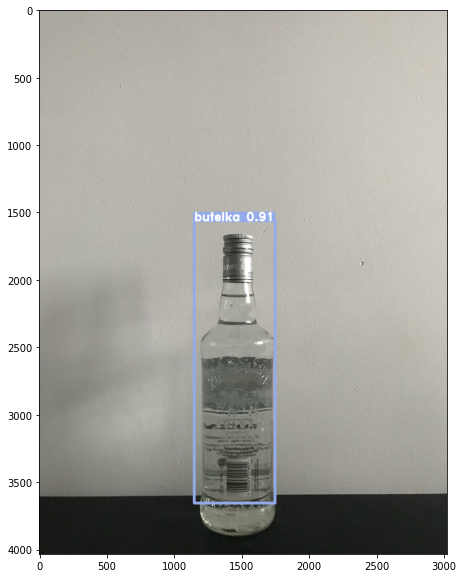

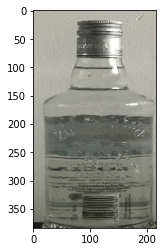

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6313.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


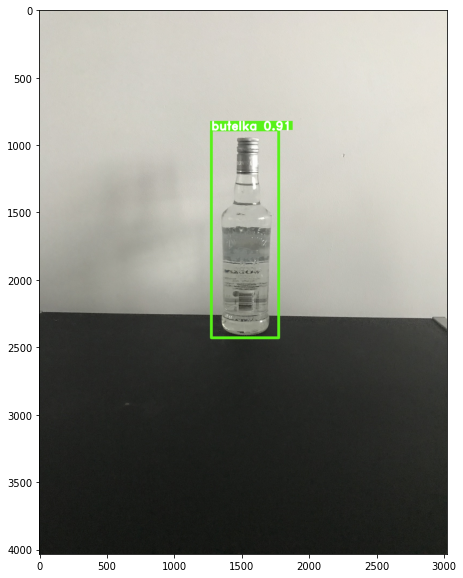

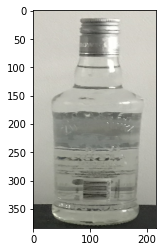

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6340.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


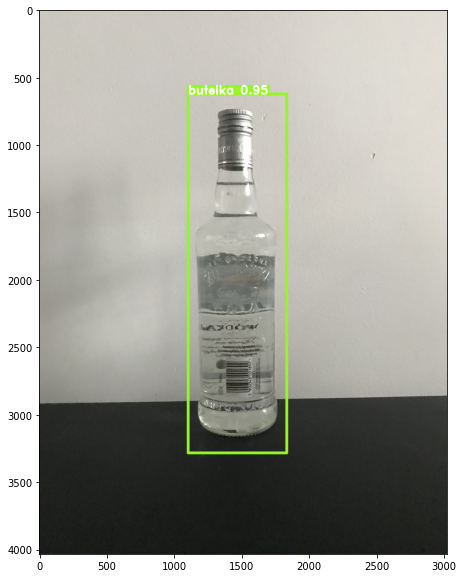

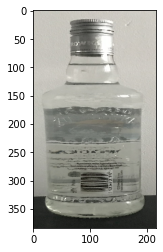

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6333.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


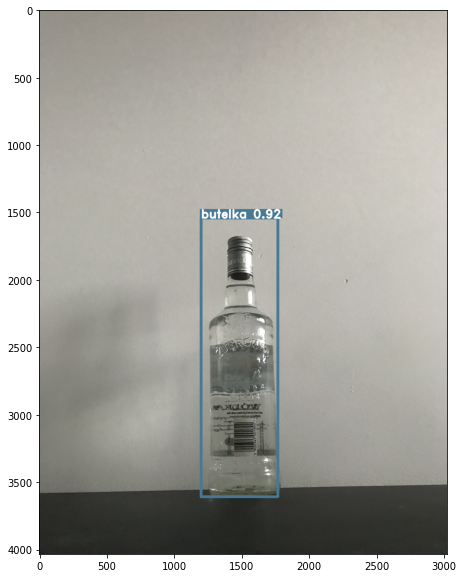

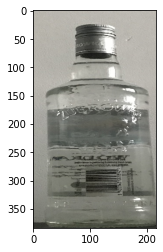

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6332.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


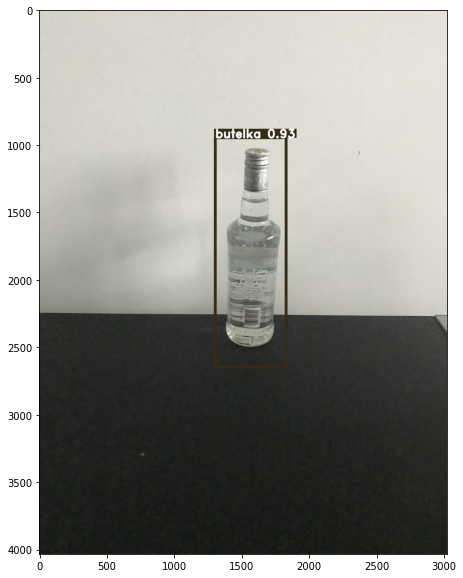

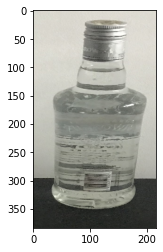

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6334.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


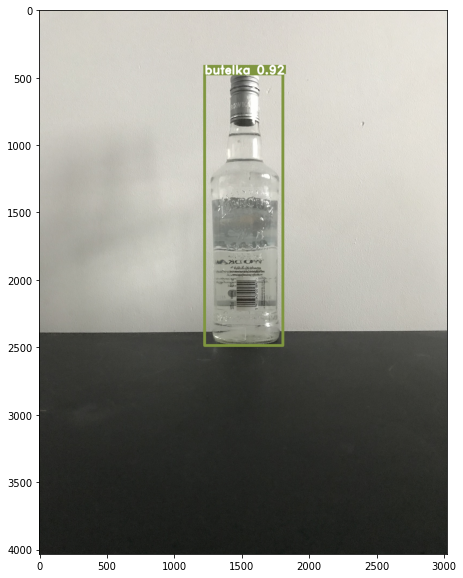

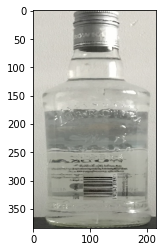

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6329.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


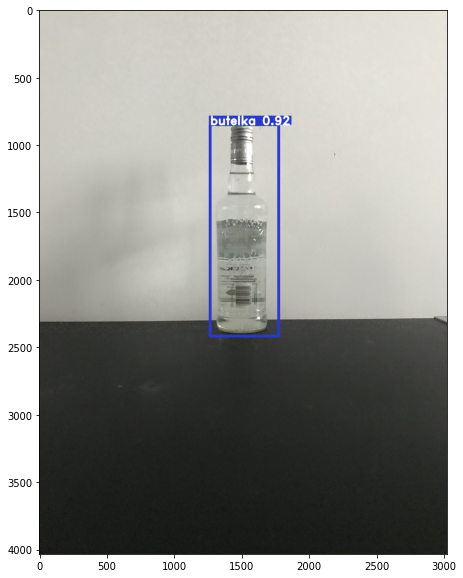

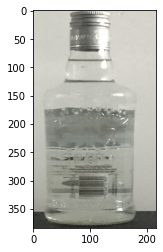

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6323.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


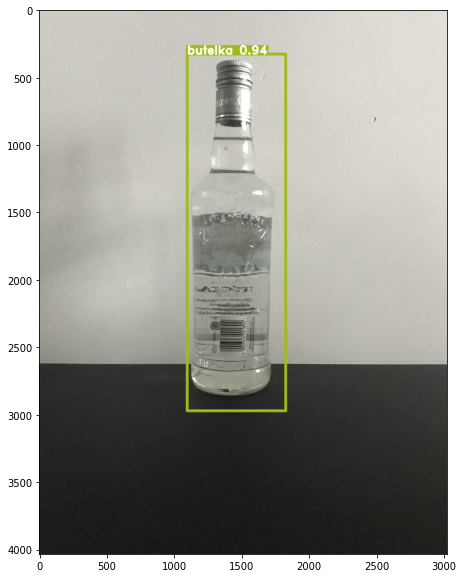

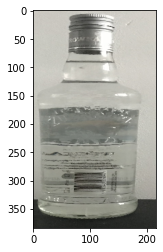

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6326.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


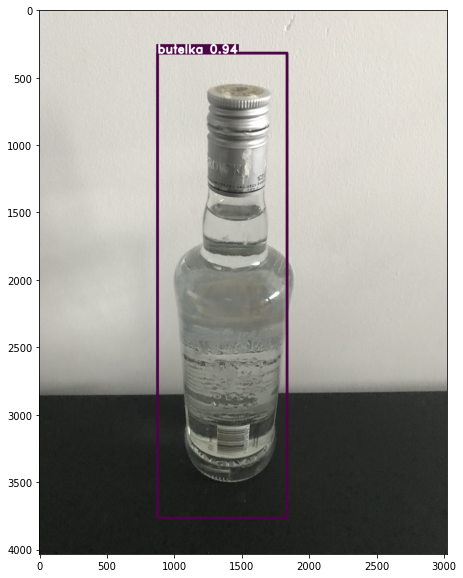

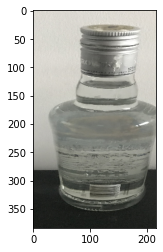

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6312.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


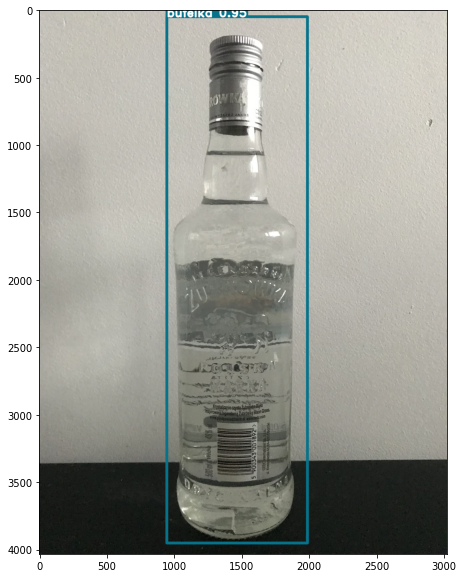

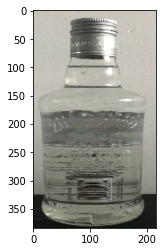

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6325.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


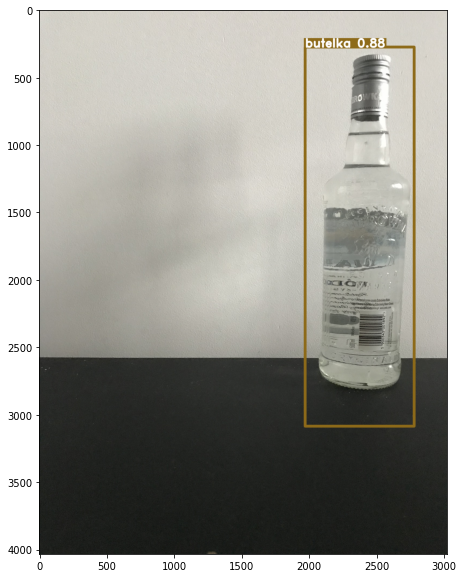

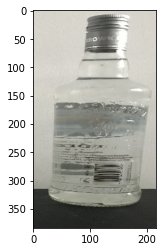

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6338.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


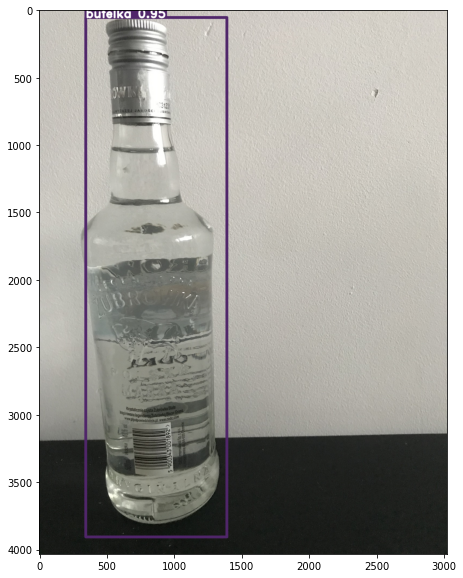

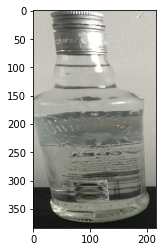

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6324.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


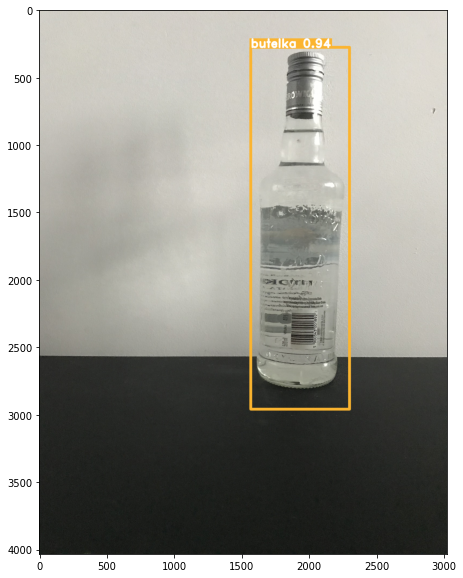

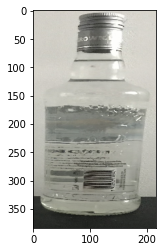

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6319.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


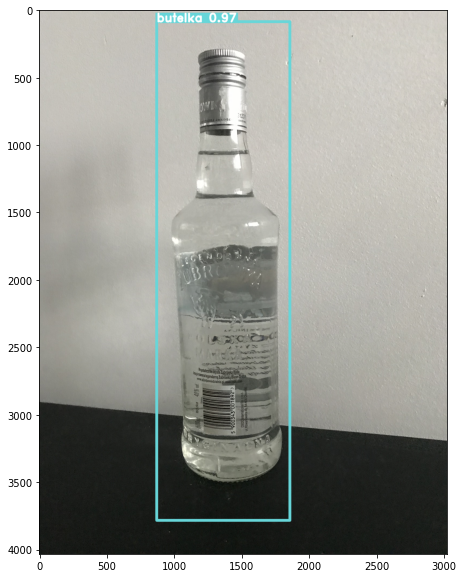

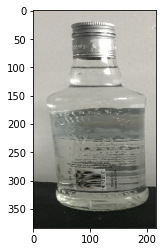

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6322.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


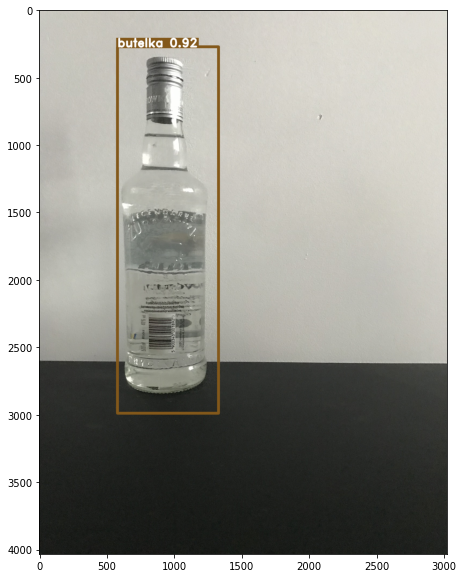

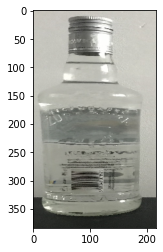

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6315.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


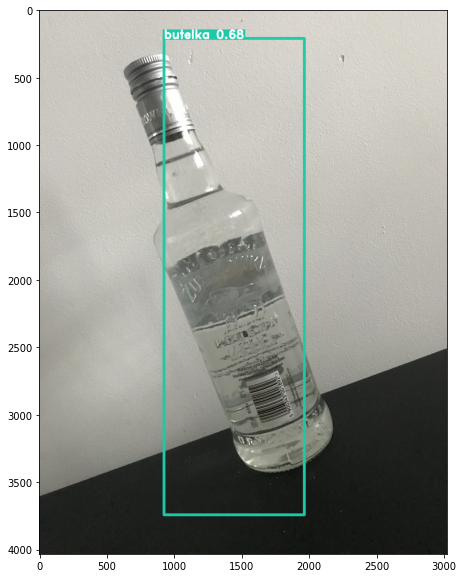

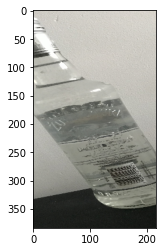

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6331.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


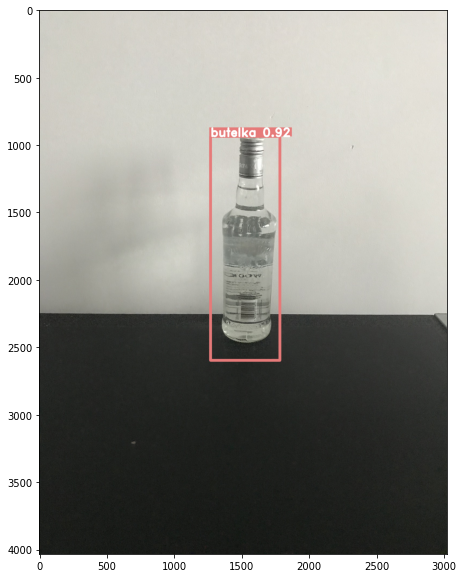

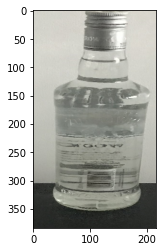

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6327.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


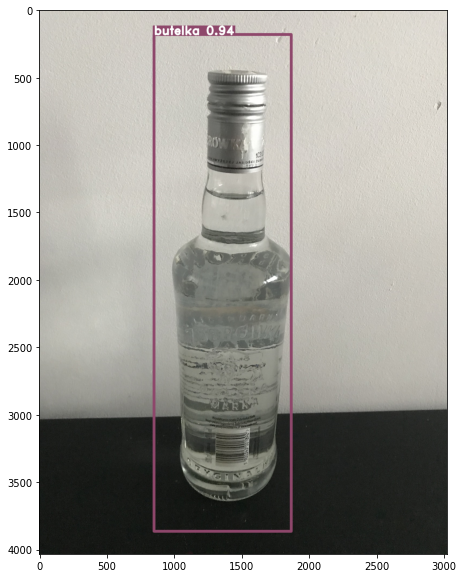

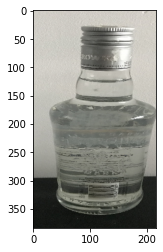

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6337.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


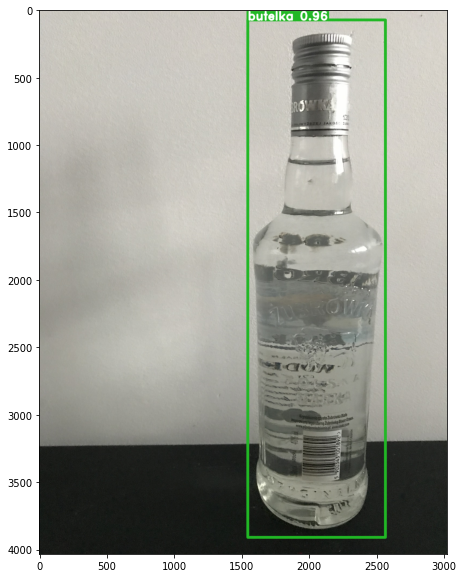

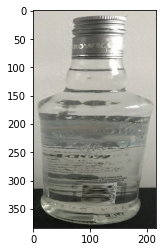

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6317.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


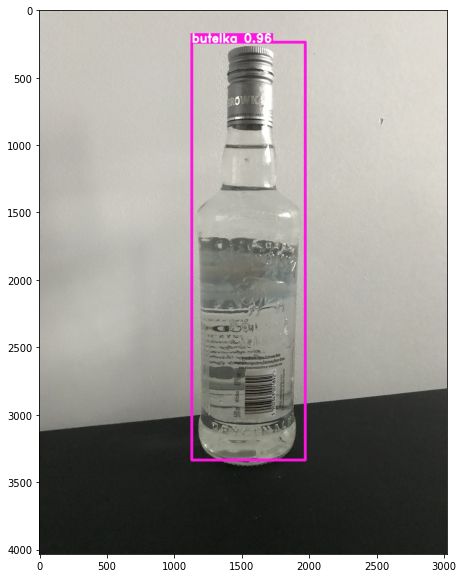

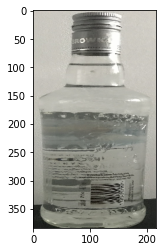

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6320.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


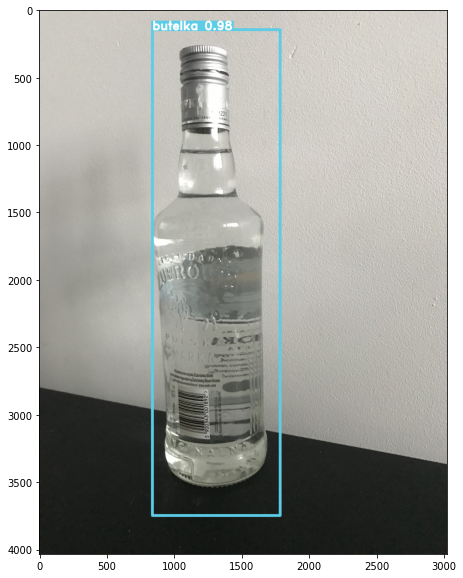

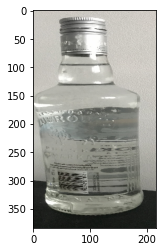

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6336.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


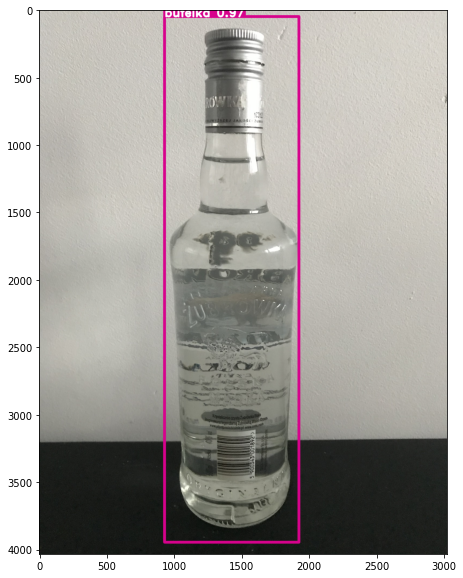

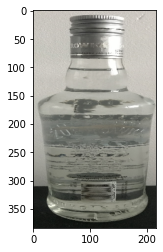

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6316.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


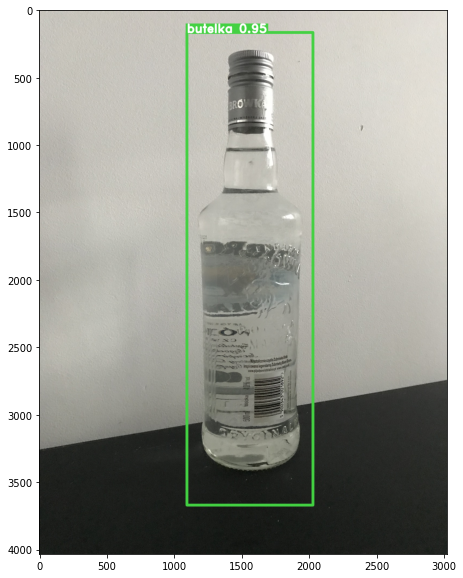

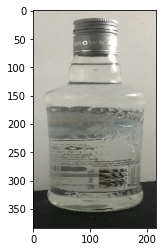

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6318.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


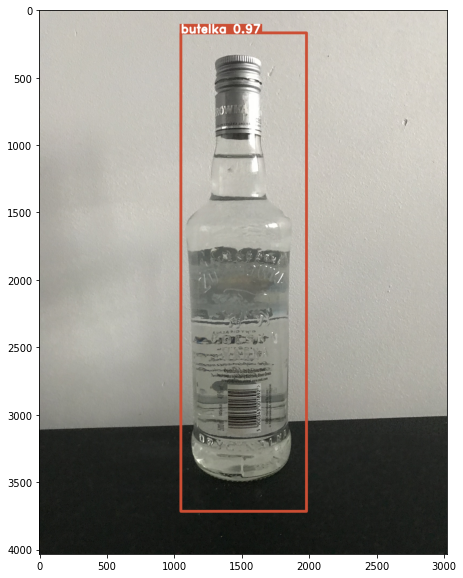

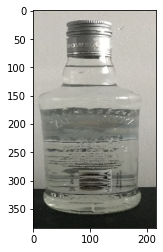

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6339.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


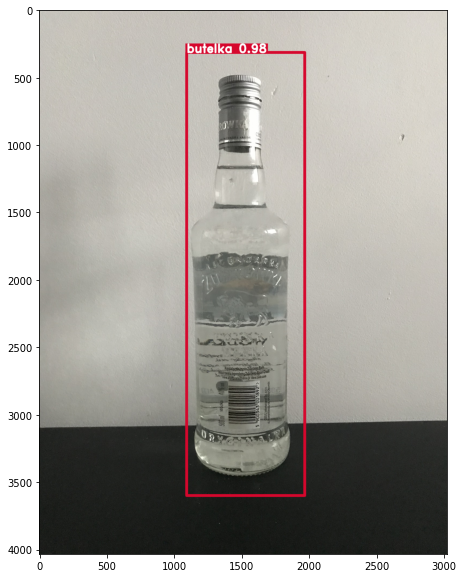

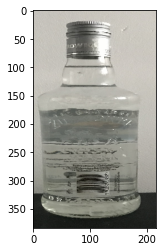

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6328.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


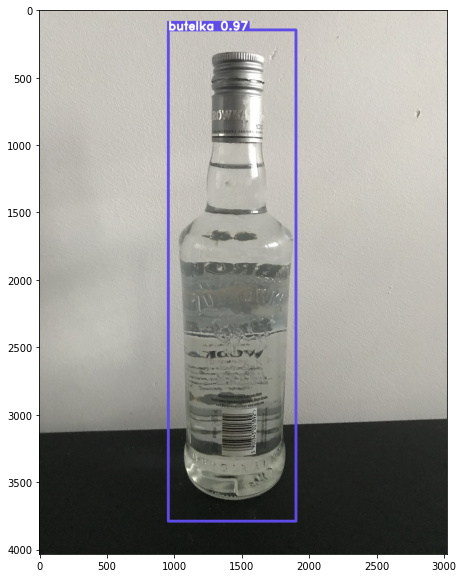

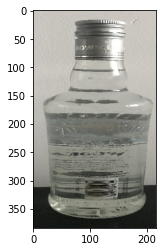

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6330.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


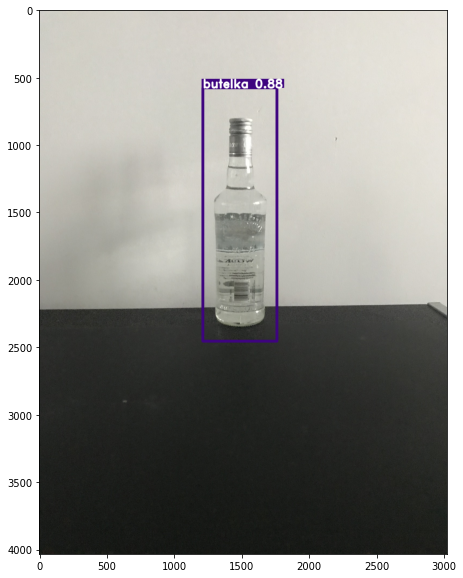

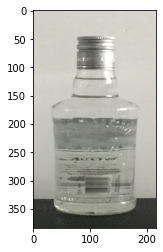

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6341.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


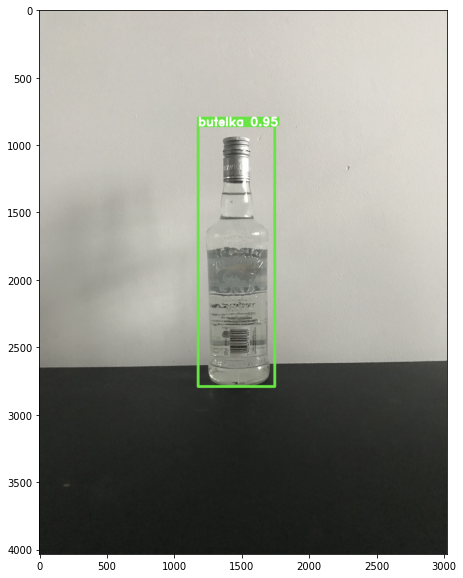

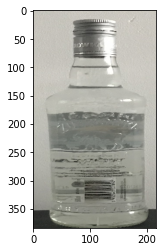

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6321.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


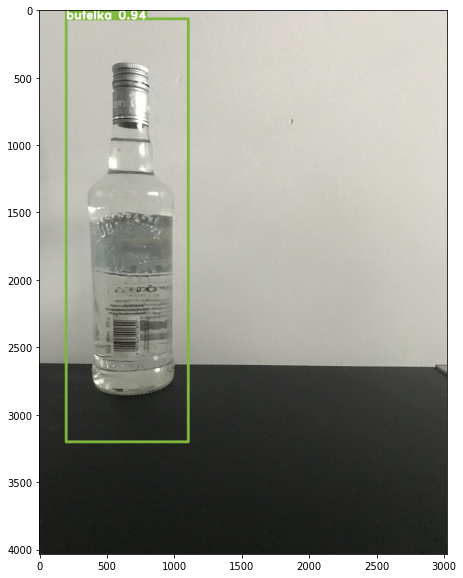

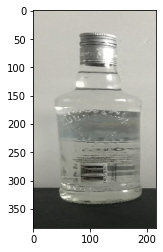

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/pelna_test/IMG_6314.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


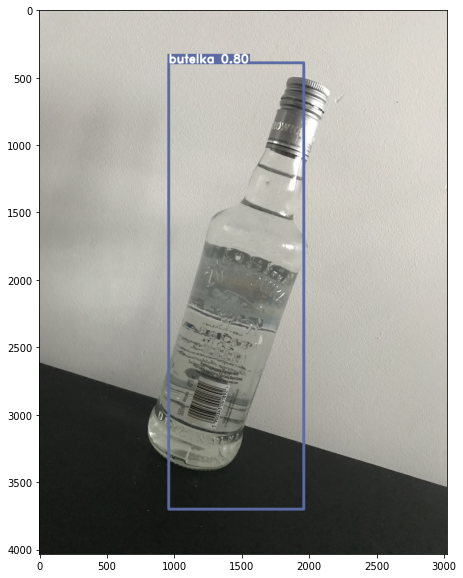

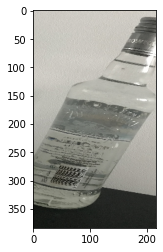

0
pelna
[[1. 0. 0.]]
30 na 30 było poprawny
../../dataset/butelka/test/w_czesci/IMG_6295.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


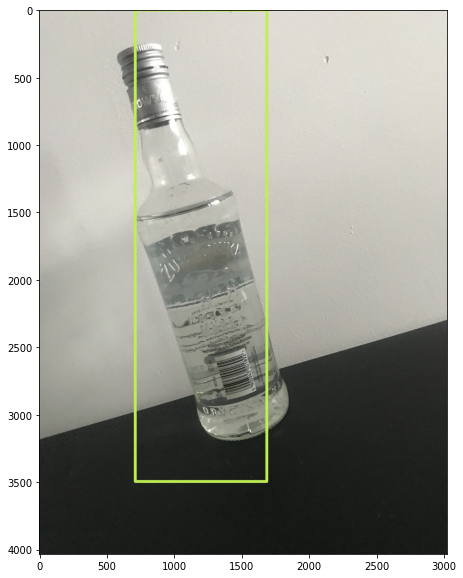

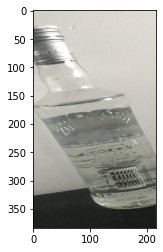

1
w_czesci
[[5.3556752e-17 1.0000000e+00 0.0000000e+00]]
../../dataset/butelka/test/w_czesci/IMG_9868.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


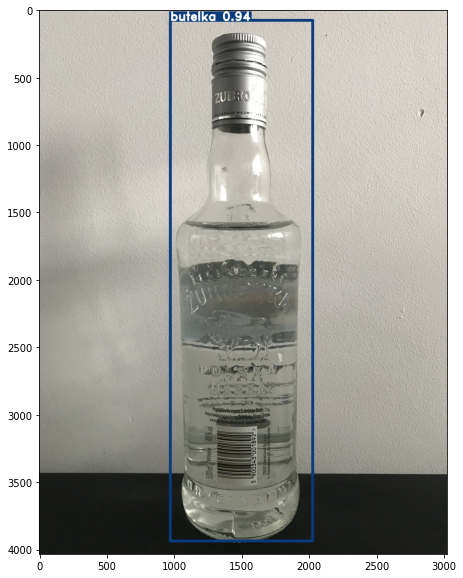

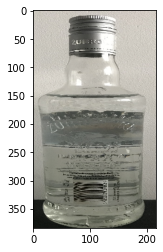

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6290.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


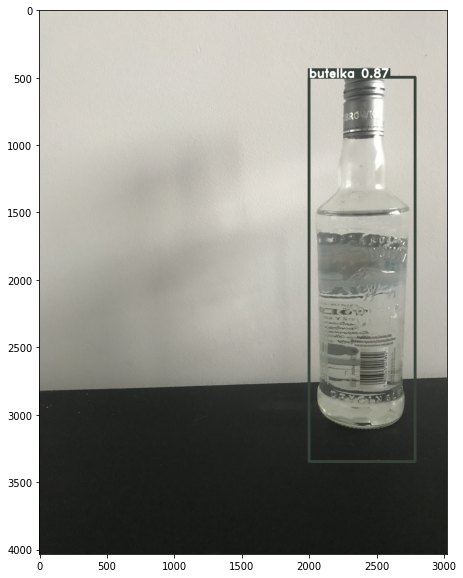

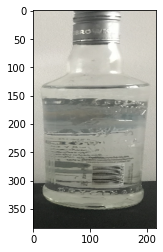

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9870.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


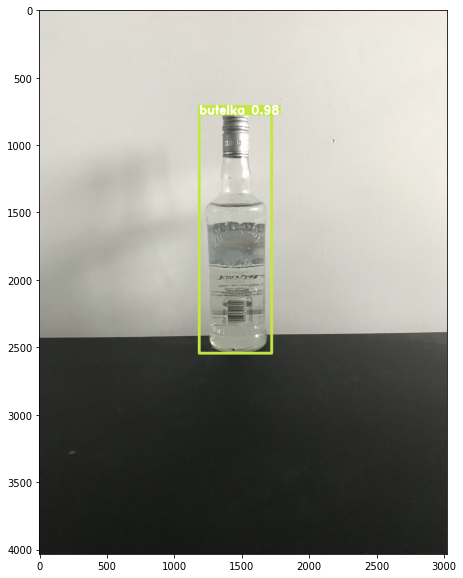

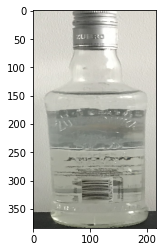

1
w_czesci
[[0.00211809 0.9978818  0.        ]]
../../dataset/butelka/test/w_czesci/IMG_9874.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


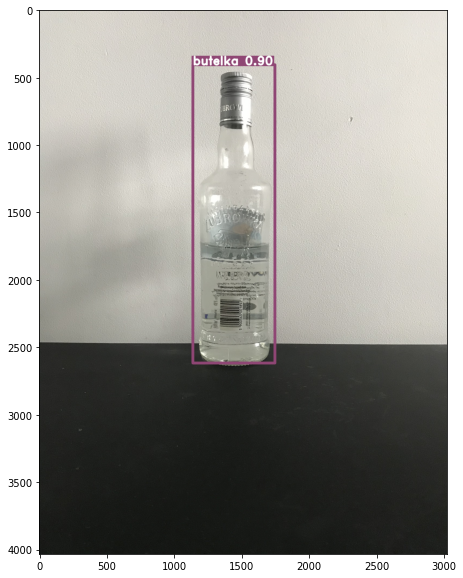

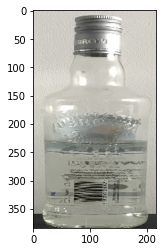

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6346.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


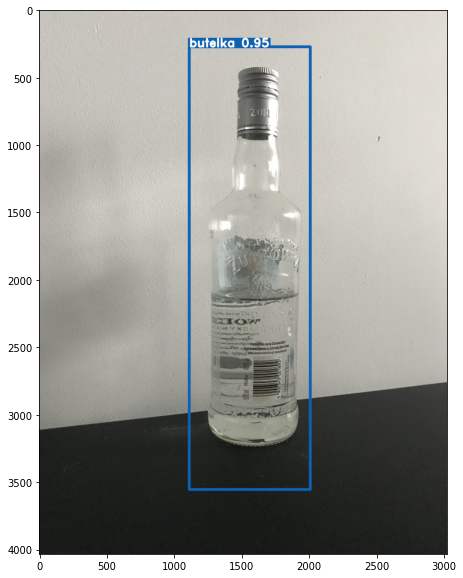

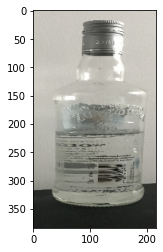

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9869.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


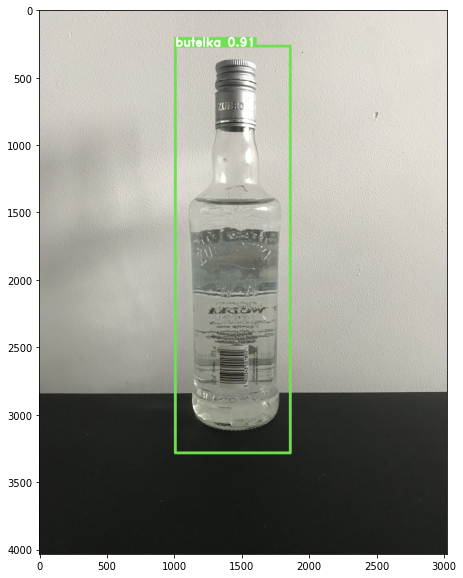

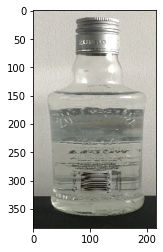

1
w_czesci
[[4.1563028e-29 1.0000000e+00 0.0000000e+00]]
../../dataset/butelka/test/w_czesci/IMG_6285.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


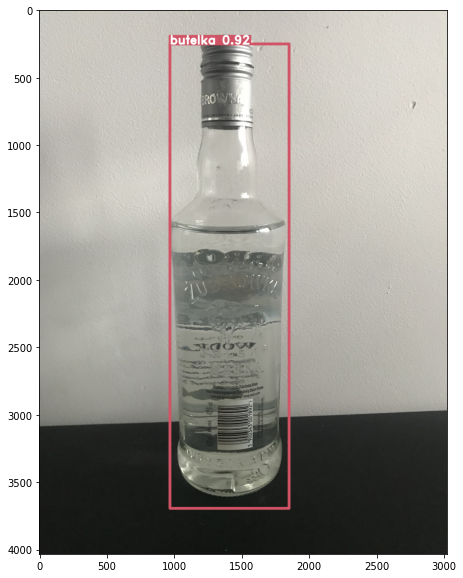

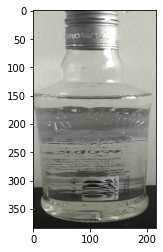

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6351.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


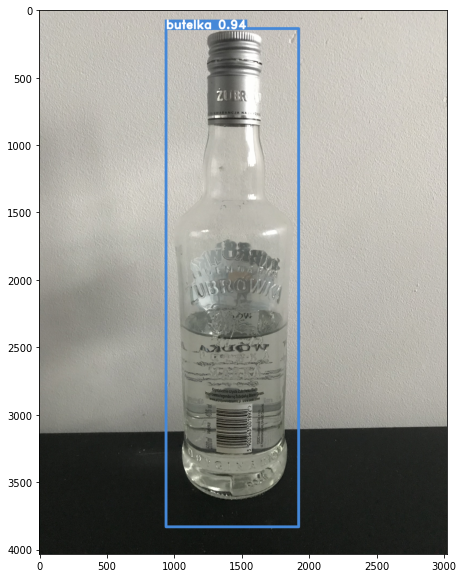

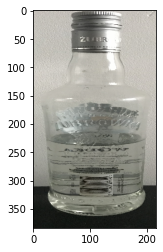

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9872.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


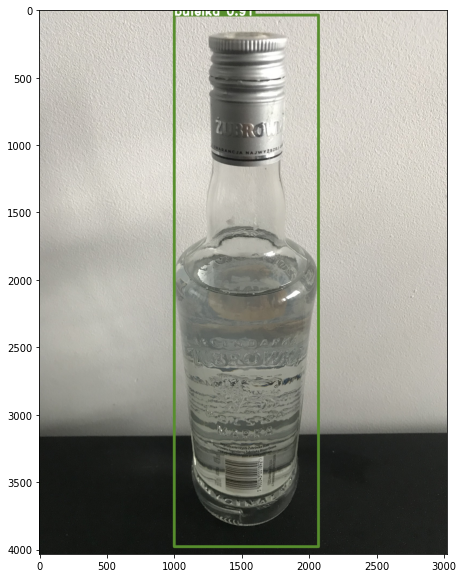

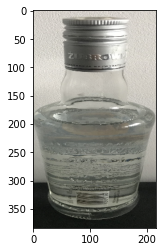

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6342.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


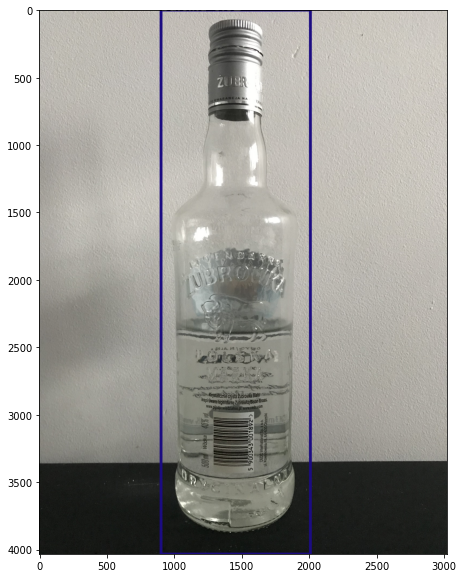

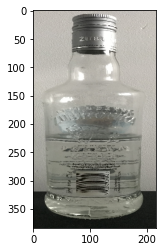

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_5064.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


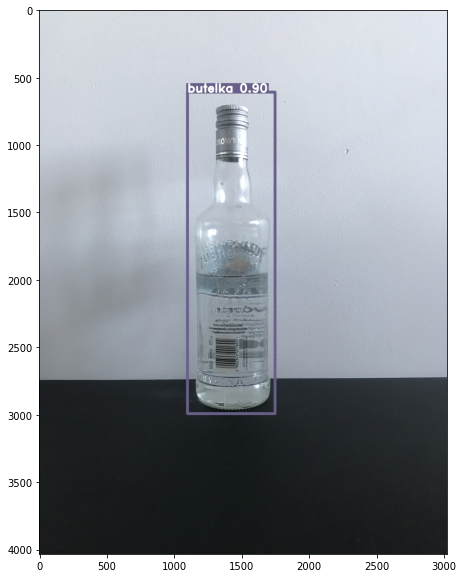

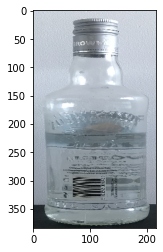

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9877.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


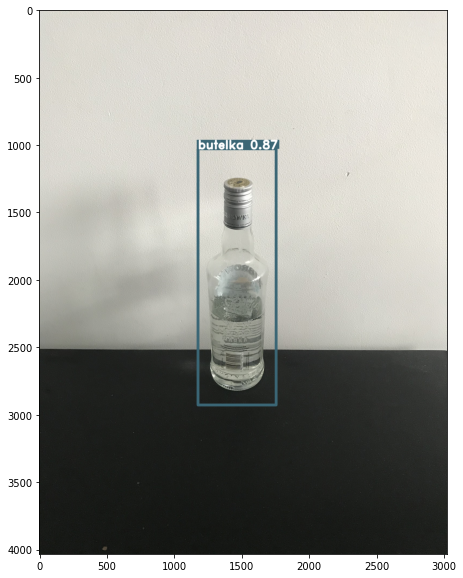

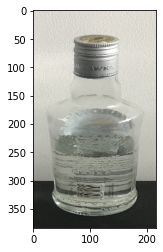

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6350.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


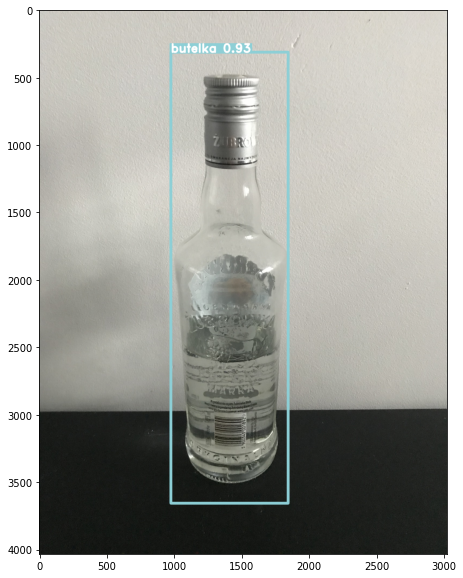

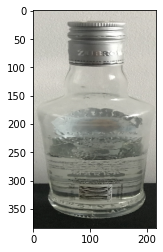

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6348.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


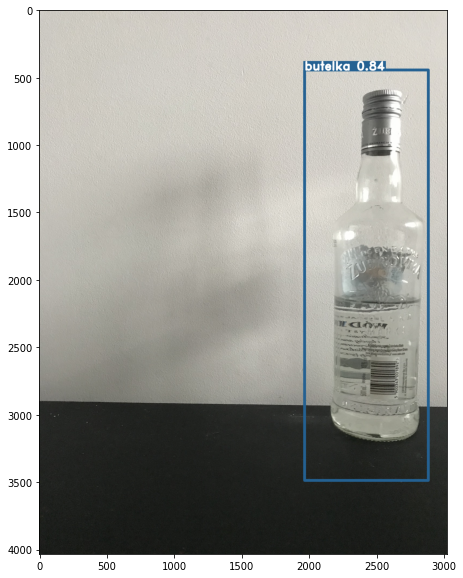

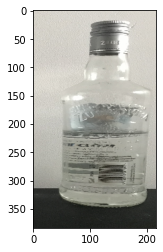

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6343.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


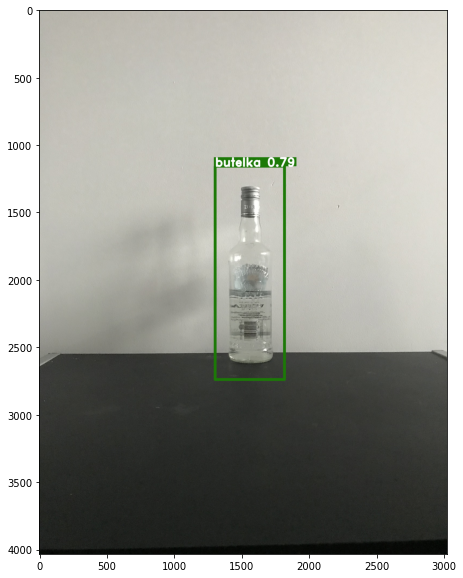

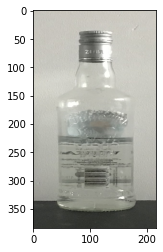

2
pusta
[[0.         0.08120726 0.9187927 ]]
../../dataset/butelka/test/w_czesci/IMG_5081.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


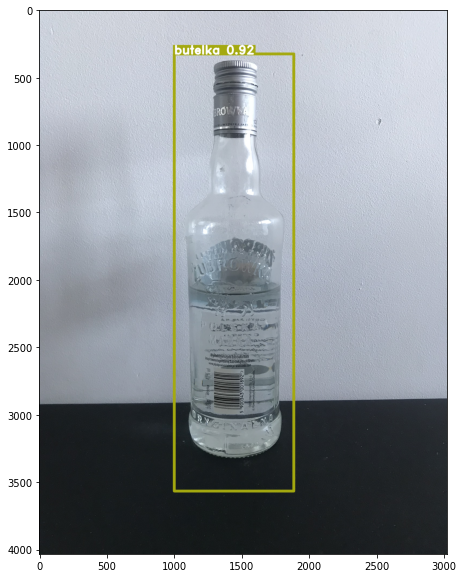

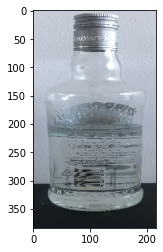

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6345.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


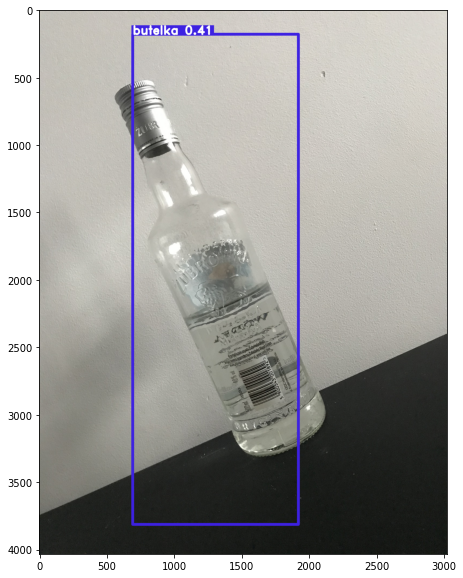

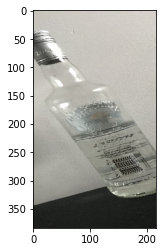

0
pelna
[[1.0000000e+00 8.1947315e-25 0.0000000e+00]]
../../dataset/butelka/test/w_czesci/IMG_6282.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


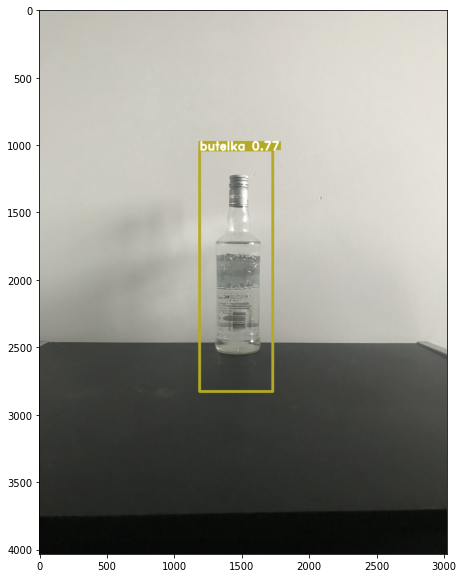

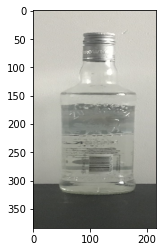

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6292.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


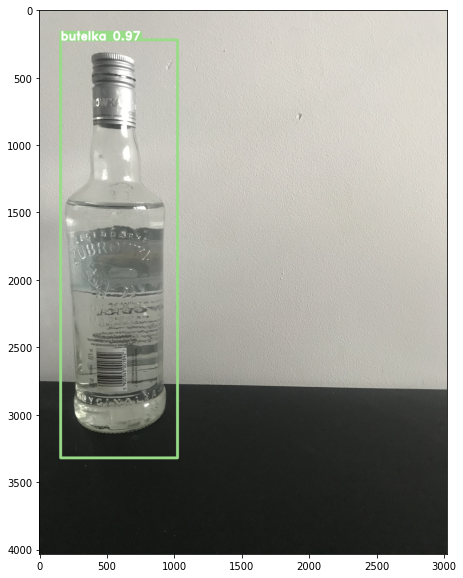

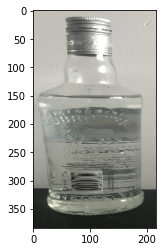

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9876.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


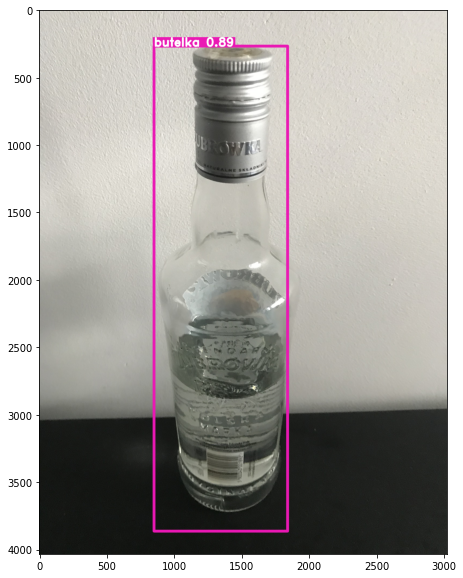

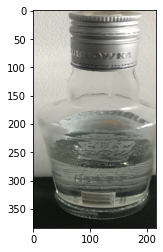

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9871.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


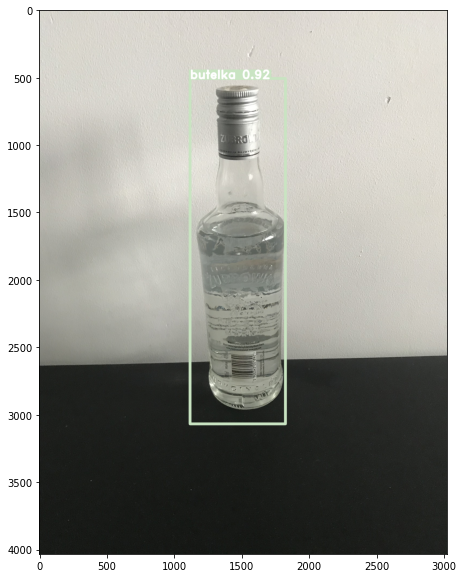

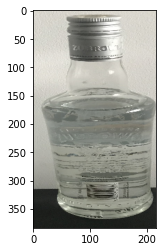

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9873.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


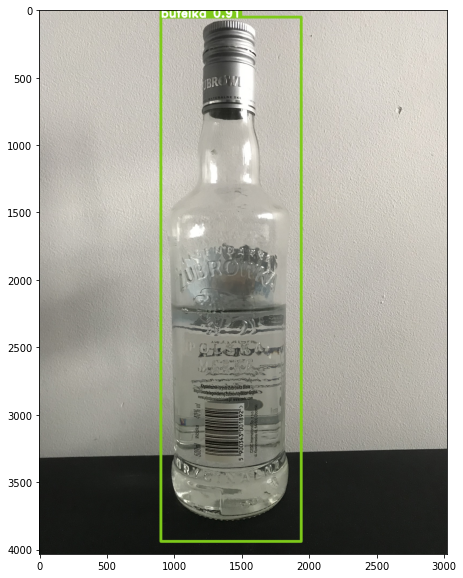

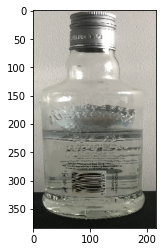

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6293.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


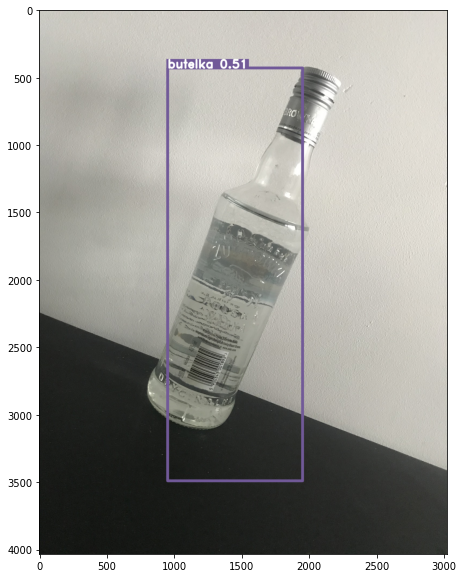

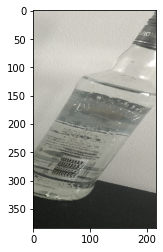

0
pelna
[[1. 0. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6284.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


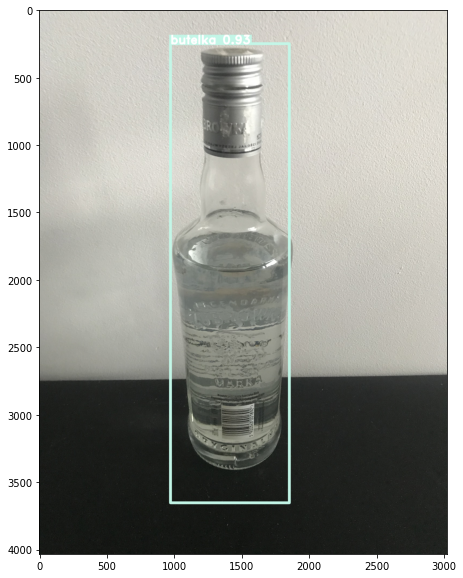

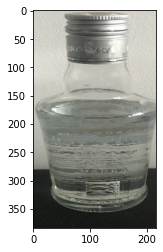

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6344.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


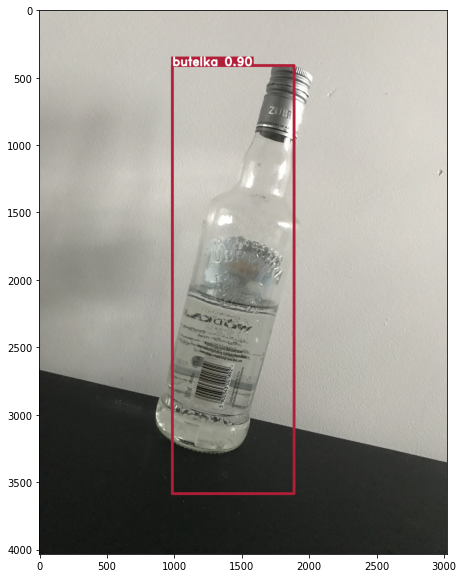

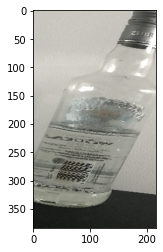

1
w_czesci
[[1.5674614e-26 1.0000000e+00 0.0000000e+00]]
../../dataset/butelka/test/w_czesci/IMG_6287.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


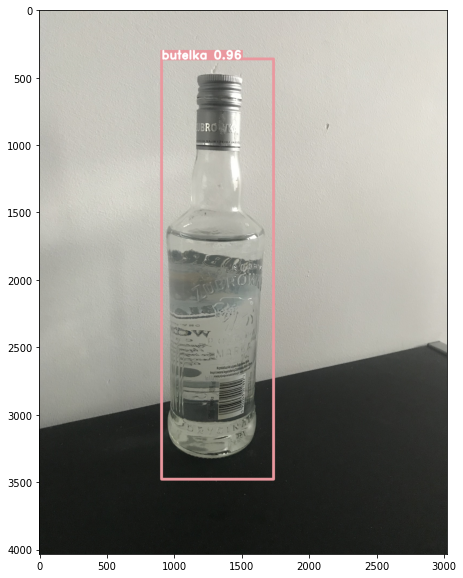

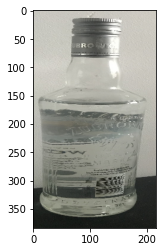

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_9875.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


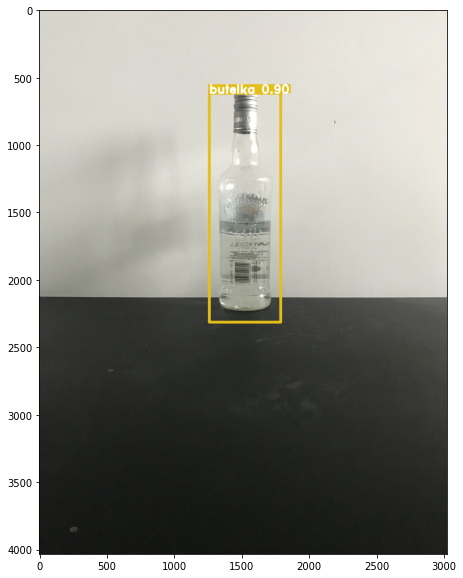

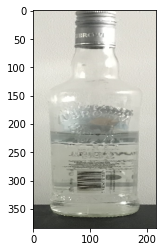

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6289.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


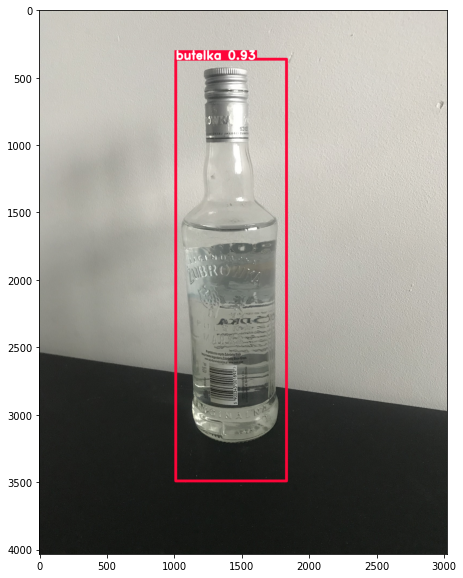

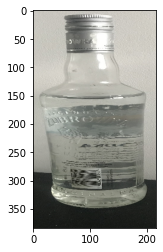

1
w_czesci
[[0. 1. 0.]]
../../dataset/butelka/test/w_czesci/IMG_6281.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


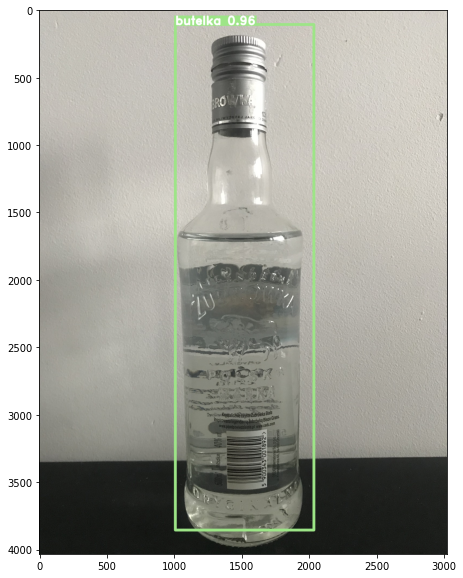

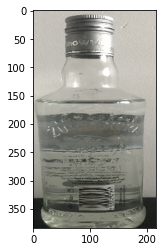

1
w_czesci
[[0. 1. 0.]]
27 na 30 było poprawny
../../dataset/butelka/test/pusta_test/IMG_9373.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


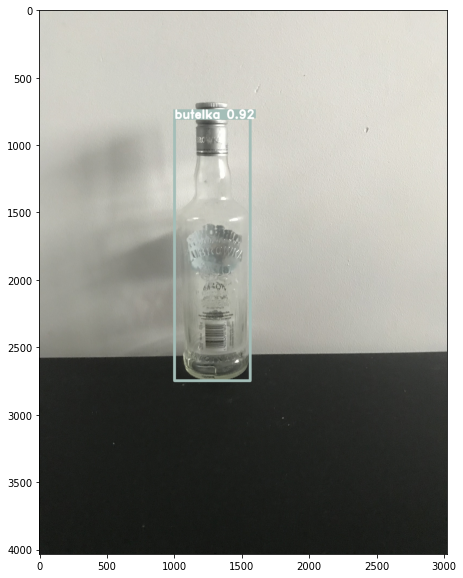

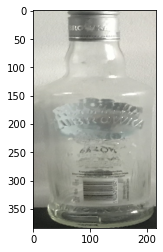

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9393.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


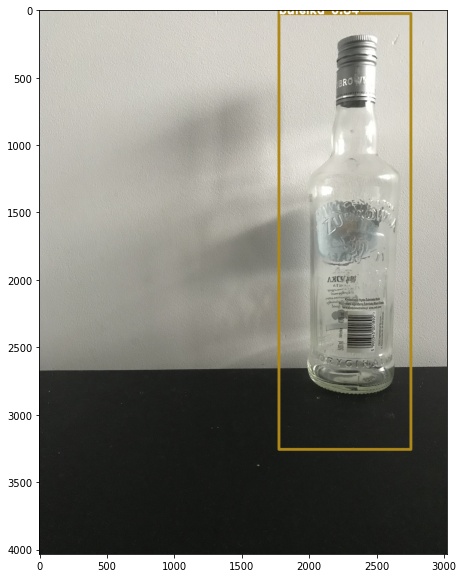

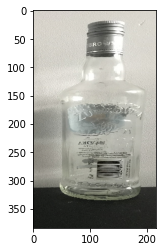

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9410.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


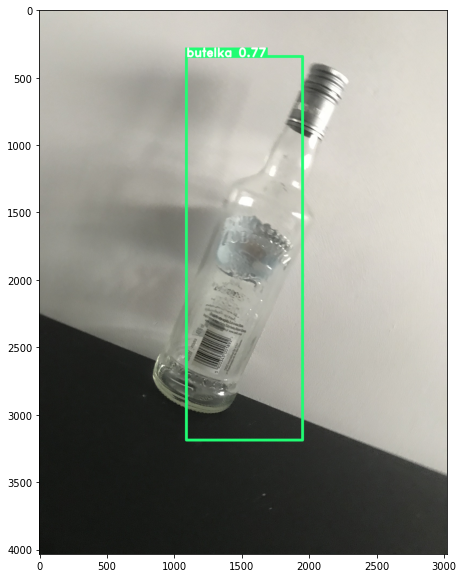

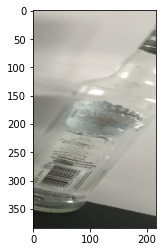

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9389.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


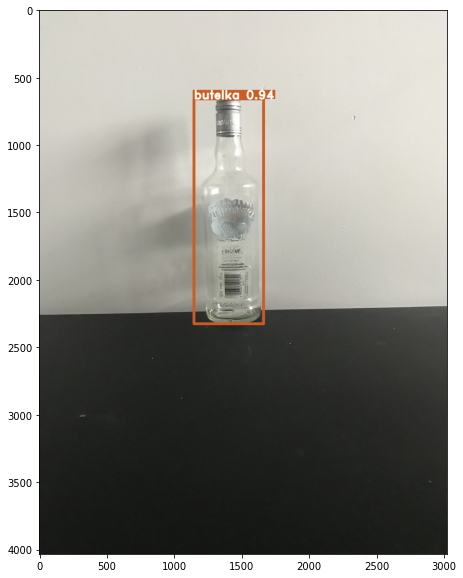

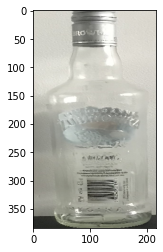

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9415.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


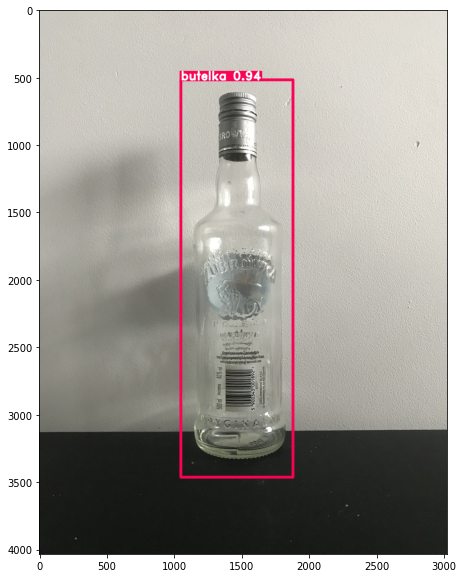

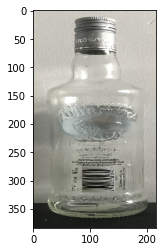

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9400.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


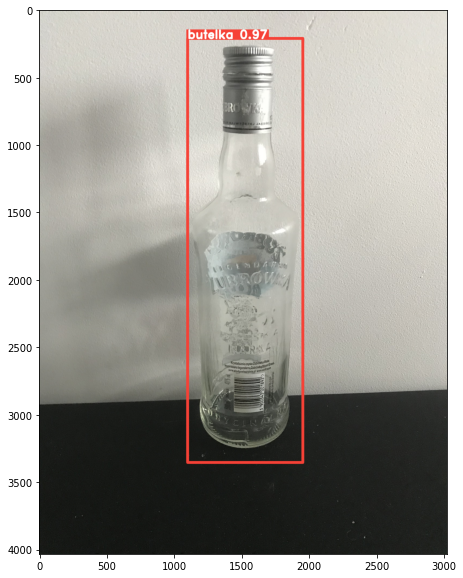

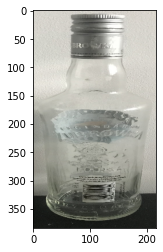

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9390.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


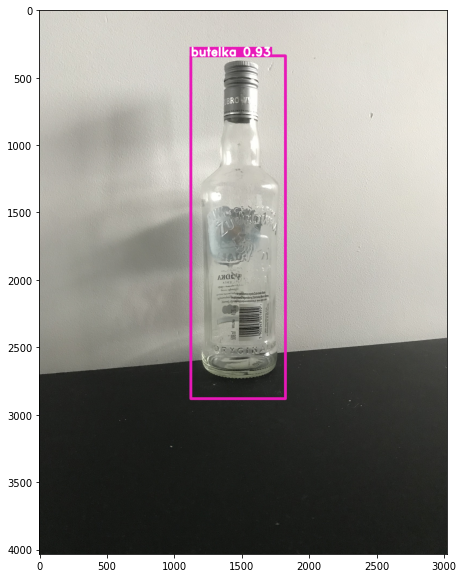

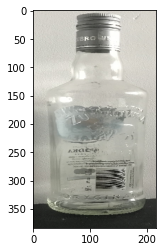

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9408.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


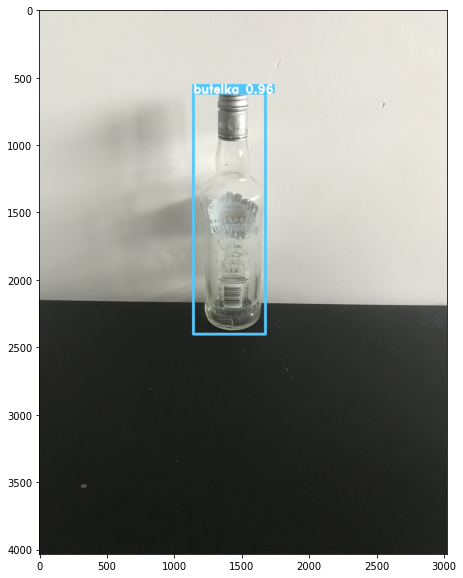

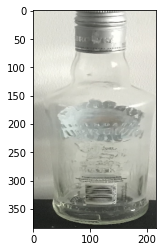

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9401.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


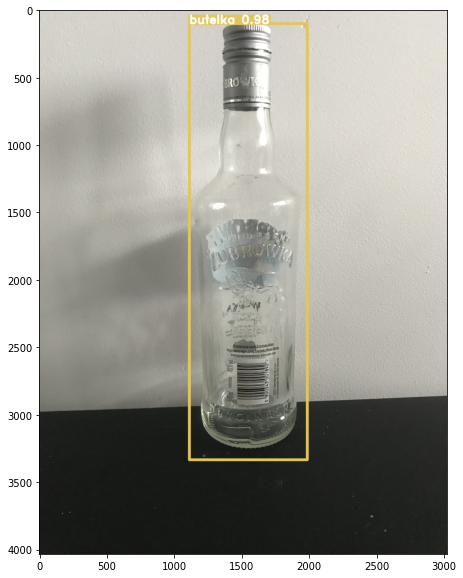

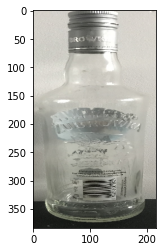

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9405.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


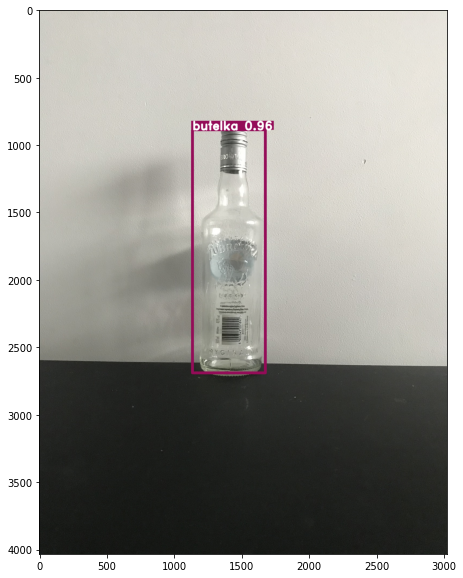

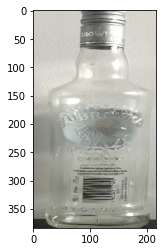

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9399.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


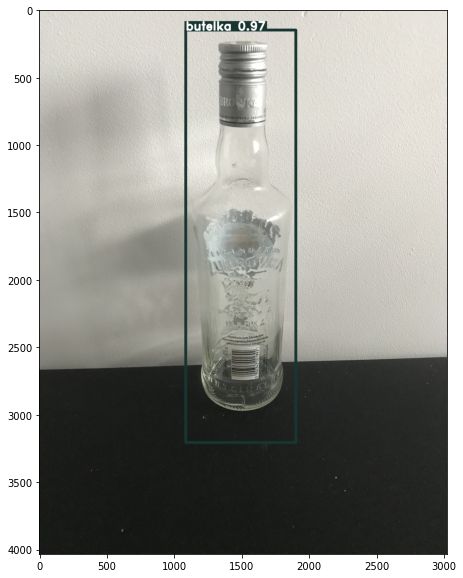

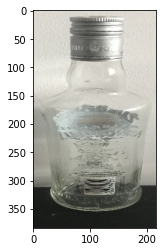

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9409.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


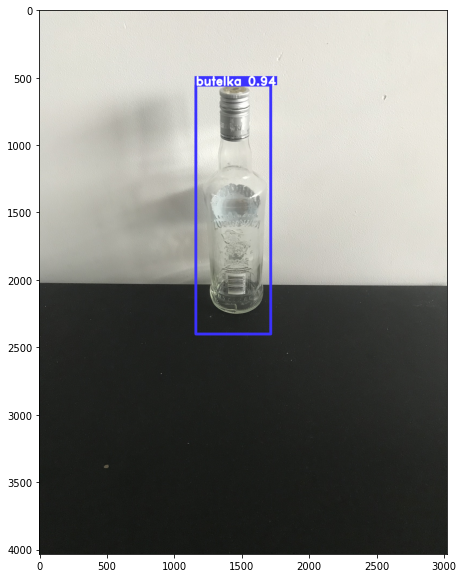

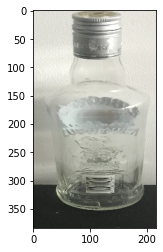

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9403.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


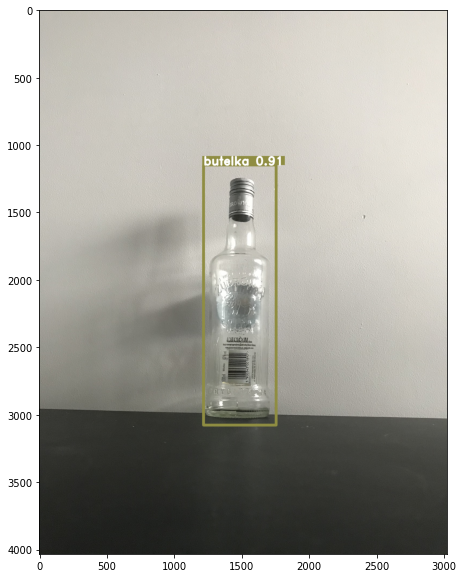

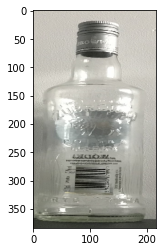

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9414.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


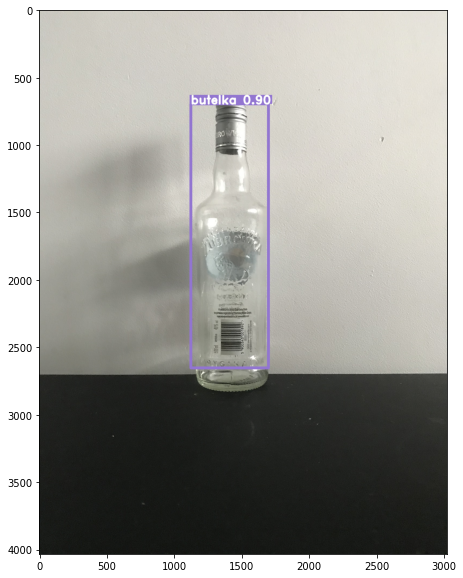

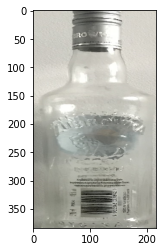

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9413.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 0


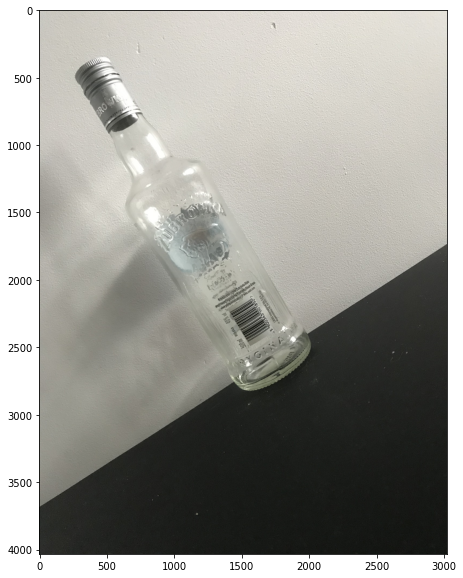

../../dataset/butelka/test/pusta_test/IMG_9407.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


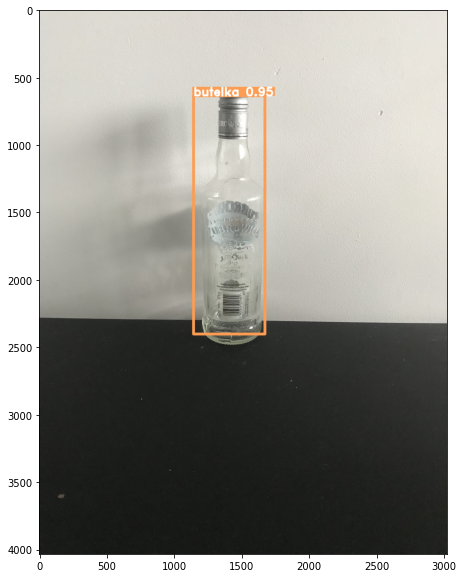

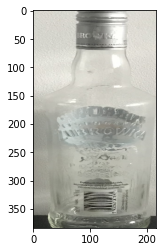

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9398.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


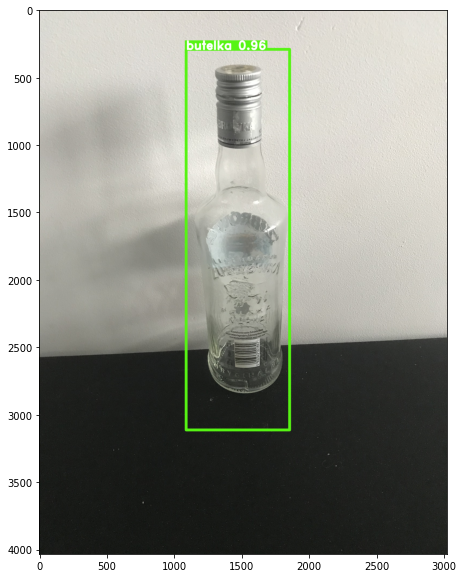

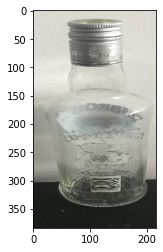

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9392.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


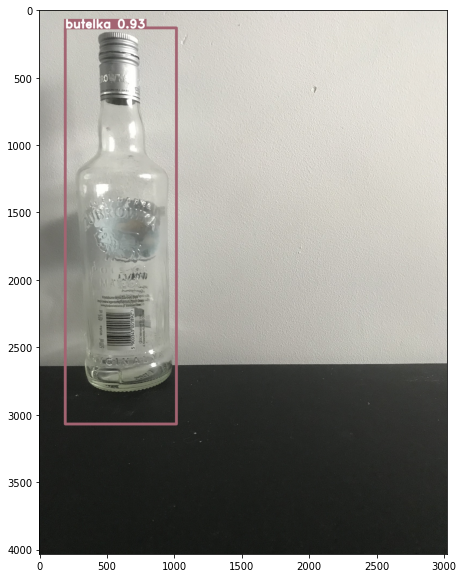

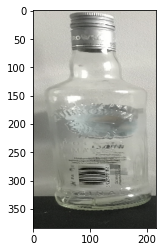

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9394.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


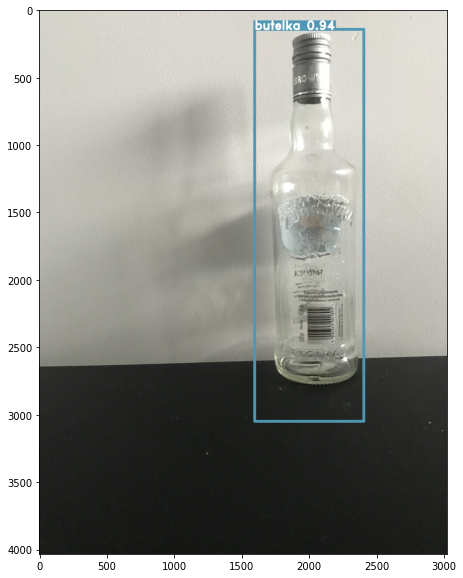

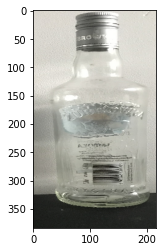

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9331.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


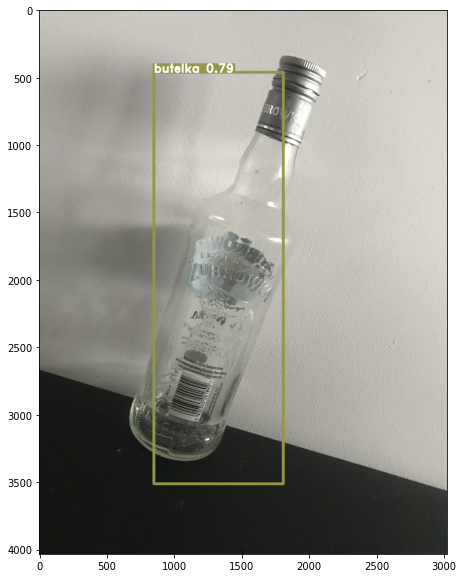

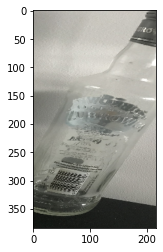

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9396.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


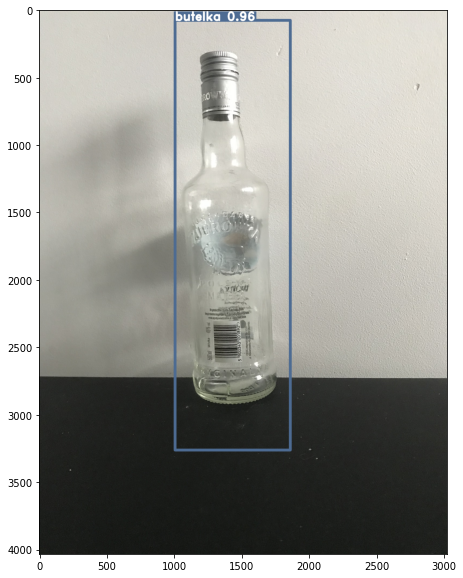

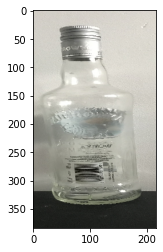

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9406.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


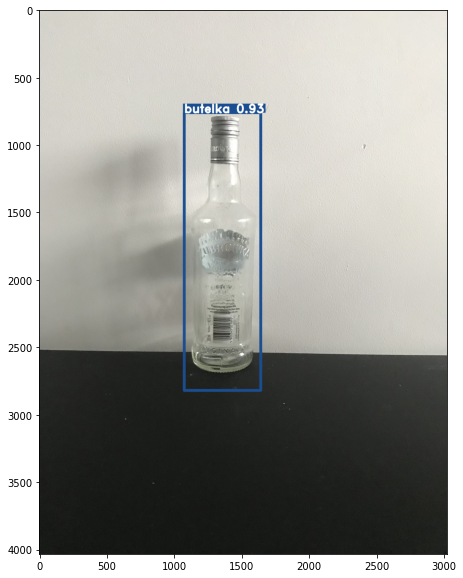

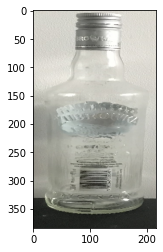

2
pusta
[[0. 0. 1.]]
../../dataset/butelka/test/pusta_test/IMG_9412.JPG
img shape:  (4032, 3024, 3)
# of bboxes: 1


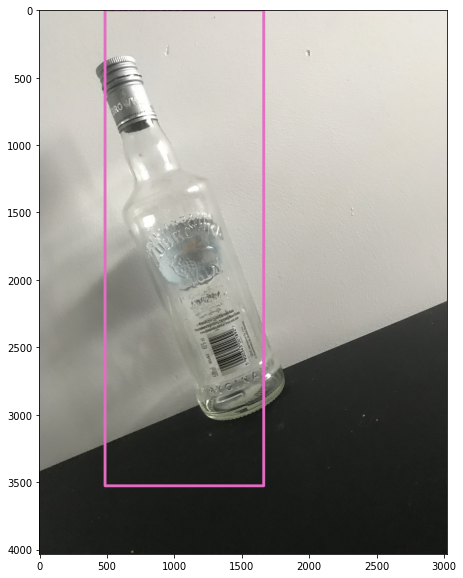

In [ ]:
check_directory('../../dataset/butelka/test/', ['pelna_test', 'w_czesci', 'pusta_test'])